In [344]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [345]:
import sys
sys.path.insert(0, "/Users/aninauldum/Documents/Datalogi/bachelor/BA/hyperiax_internal_data/")
import hyperiax

In [696]:
import jax
jax.config.update("jax_enable_x64", True)
from jax import numpy as jnp
from jax.random import PRNGKey, split

import pandas as pd
import numpy as np

from hyperiax.execution import OrderedExecutor
from hyperiax.models import UpLambdaReducer, DownLambda, UpLambda

from hyperiax.tree.topology import read_topology, TopologyNode
from hyperiax.tree import HypTree

from hyperiax.plotting import plot_tree, plot_tree_text, plot_shape_2d, plot_tree_2d_scatter, plot_tree_3d_scatter, plot_tree_2d_shape

from hyperiax.mcmc import ParameterStore, VarianceParameter
from hyperiax.mcmc.metropolis_hastings import metropolis_hastings
from hyperiax.mcmc.statistics import gelman_rubin
from hyperiax.mcmc.plotting import trace_plots

import matplotlib.pyplot as plt
from tqdm import tqdm
import pandas as pd
import matplotlib.animation as animation
from mpl_toolkits.mplot3d import Axes3D  # required for 3D plotting
import pickle

In [347]:
# seed,
seed = 42
#import os; seed = int(os.urandom(5).hex(), 16)
key = PRNGKey(seed)

HypTree(size=33, levels=7, leaves=17, inner nodes=15)
                                                                                                                                   
                                                                                                                                   
                                     ┌────────────────────────────────────────────────────────────────────────────────────────────┴─────────────────────────────────────────────────────────────────────────────────────────────┐
                                    None                                                                                                                                                                                       None                                                      
      ┌──────────────────────────────┴───────────────────────────────┐                                                                                                        

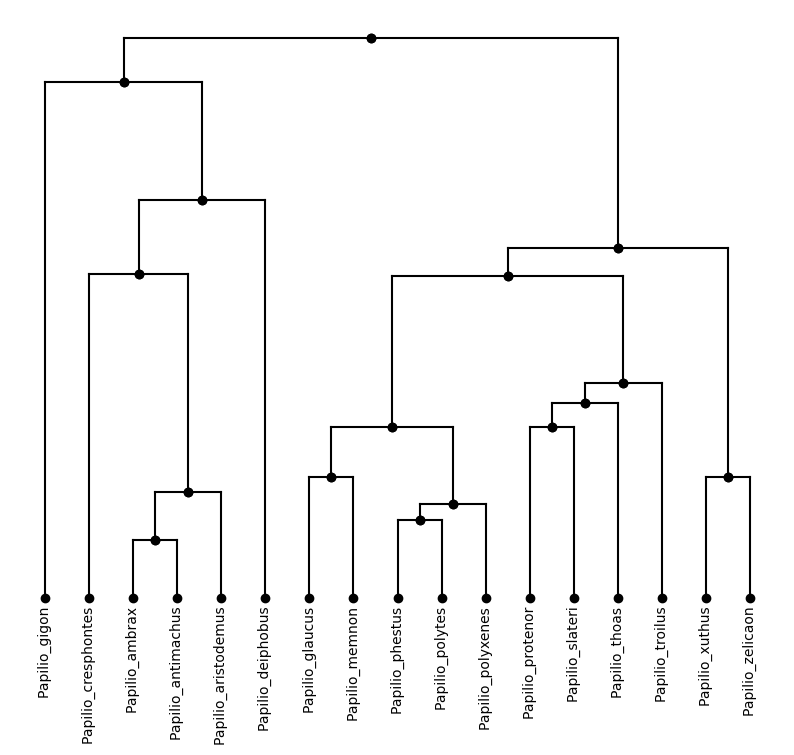

In [348]:

# data and landmarks dimensions
d=2

filename = "/Users/aninauldum/Documents/Datalogi/bachelor/BA/hyperiax_internal_data/data/butterflies/papilio_male_dataset/papilio_tree.tree"
filename_csv = "/Users/aninauldum/Documents/Datalogi/bachelor/BA/hyperiax_internal_data/data/butterflies/papilio_male_dataset/papilio_shapes.csv"
#filename = "hyperiax_internal_data/data/butterflies/male_dataset/species_tree.tre"
#filename_csv = "hyperiax_internal_data/data/butterflies/male_dataset/reconstructed_shapes.csv"
with open(filename, "r") as file:
    string_tree = file.read()
tree = read_topology(string_tree)

# print the tree
print(tree)
plot_tree_text(tree)
plot_tree(tree,inc_names=True)

                         edges          0          1          2          3  \
node_names                                                                   
xx_0                 13.435098  24.127419  45.308372  40.163723  69.381874   
xx_1                 23.277729  23.127708  50.703790  39.201443  74.751335   
xx_2                 31.773878  25.207127  37.467770  41.664463  62.065840   
Papilio_gigon        55.361300  23.735891  58.050270  37.984425  81.869570   
xx_3                 27.830029  22.953447  47.230633  39.802616  70.985880   
xx_4                 13.047104  23.665522  36.524902  39.102055  62.031918   
xx_5                 31.029999  28.953800  39.043580  47.986397  61.484860   
xx_6                 23.462488  22.284794  41.192505  40.080044  64.364494   
Papilio_deiphobus    42.669700  24.224997  57.527710  39.766480  82.669380   
xx_7                 22.156902  24.496191  42.608654  40.860800  68.013410   
xx_8                 18.288342  23.250410  31.014938  37.981045 

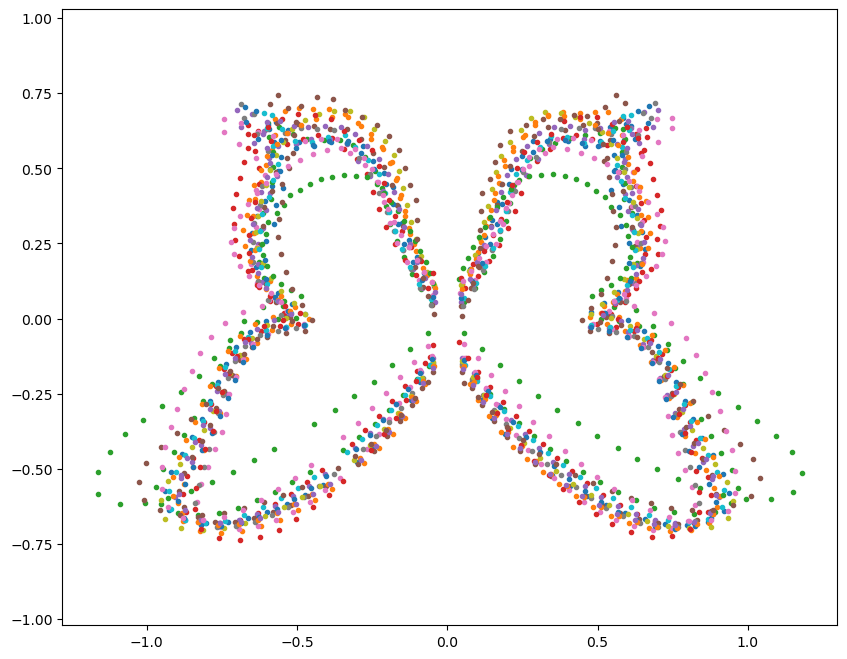

In [ ]:
n_steps = 25

landmarks_edges = pd.read_csv(filename_csv, sep=",", header = 0)
node_names = landmarks_edges['node_names'] 
landmarks_edges = landmarks_edges.set_index('node_names')
landmarks = landmarks_edges.drop(columns="edges")
landmarks = landmarks.to_numpy()

print(landmarks_edges)

# Check for NaN values in landmarks array
nan_rows = jnp.where(jnp.isnan(landmarks).any(axis=1))[0]
if len(nan_rows) > 0:
    print("Warning: NaN values found in landmarks array at row(s):", nan_rows)
n = landmarks.shape[1]//d
print("n landmarks: ",n)
landmarks = landmarks.reshape((-1,n,d))
landmarks = jnp.delete(landmarks,66,axis=1) # drop row with coinciding landmarks
landmarks = landmarks.reshape((landmarks.shape[0],-1))
n = landmarks.shape[1]//d
print("n landmarks after removing coinciding landmarks: ",landmarks.shape)

n_shapes = landmarks.shape[0]
landmarks = 2*1e-3*landmarks.reshape((n_shapes,-1,d))[:,::1].reshape((n_shapes,-1))

# add landmarks to tree 
tree.add_property('value', shape=(n_steps+1,n*d,))

tree.data['value'] = tree.data['value'].at[:].set(landmarks[:,None,:])
leaf_values = tree.data['value'][tree.is_leaf][:,-1]

fig,ax = plt.subplots(figsize=(10,8))
for leaf in tree.iter_topology_leaves_bfs():
    plot_shape_2d(tree.data['value'][leaf.id][-1],ax=ax)
       
for i,node in enumerate(tree.iter_topology_bfs()):
    node.name = node_names[i]
    
my_nodenames_leaves = []    
leaves_parents = []
for node in tree.iter_topology_leaves_bfs():  
    my_nodenames_leaves.append(node.name) 
    leaves_parents.append(node.parent.name)

In [350]:
from collections import deque
from typing import Iterator

def iter_topology_inner_nodes_post(self) -> Iterator[TopologyNode]:
    """
    Iterate over all inner nodes (excluding the root and leaves) in post-order traversal.
    """
    def post_order(node):
        for child in node.children:
            yield from post_order(child)
        if node.children and node is not self.topology_root:  # Only inner nodes
            yield node

    yield from post_order(self.topology_root)
    
def iter_topology_leaves_inorder(self) -> Iterator[TopologyNode]:
    """
    Iterate over all leaf nodes in in-order traversal.
    """
    def in_order(node):
        if not node:
            return

        if len(node.children) > 0:  # Left child exists
            yield from in_order(node.children[0])

        if not node.children:  # If node has no children, it's a leaf
            yield node

        if len(node.children) > 1:  # Right child exists
            yield from in_order(node.children[1])

    yield from in_order(self.topology_root)


def iter_topology_inner_nodes_inorder(self) -> Iterator[TopologyNode]:
    """
    Iterate over all inner nodes (excluding the root and leaves) in in-order traversal.
    """
    def in_order(node):
        if not node:
            return

        if len(node.children) > 0:  # Left child exists
            yield from in_order(node.children[0])

        if node.children and node is not self.topology_root:  # Only inner nodes (not root or leaves)
            yield node

        if len(node.children) > 1:  # Right child exists
            yield from in_order(node.children[1])

    yield from in_order(self.topology_root)
    
def iter_topology_inner_nodes_bfs(self, exclude_root = True) -> Iterator["TopologyNode"]:
    """
    Iterate over all inner nodes (excluding leaves) in a breadth-first manner.
    """
    queue = deque([self.topology_root])

    while queue:
        current = queue.popleft()
        if current.children:  # Internal nodes have children
            queue.extend(current.children)  # Add children to queue
            if exclude_root: # Exclude root if needed
                if current is not self.topology_root:  
                    yield current  # Yield only non-root inner nodes
            if not exclude_root: 
                yield current
                
def iter_topology_leaves_bfs(self) -> Iterator[TopologyNode]:
        """
        Iterate over all of the leaves in the tree, in a breadth-first manner.
        """
        queue = deque([self.topology_root])

        while queue:
            current = queue.popleft()
            if current.children:
                queue.extend(current.children)
            else:
                yield current



In [351]:
def pylogenic_matrices(tree):

    # Add cumulative edge lengths and level to tree
    tree.add_property('level', shape=(1,))
    tree.add_property('cum_sum_edge_length', shape=(1,))
        
    @jax.jit
    def down(edge_length, parent_cum_sum_edge_length, parent_level, **args):
        return {'cum_sum_edge_length': edge_length + parent_cum_sum_edge_length, 'level' : 1 + parent_level}

    downmodel = DownLambda(down_fn=down)

    exe = OrderedExecutor(downmodel)

    exe.down(tree)

    # Generate C matrix
    
    def find_shared_edge_lengths(a:TopologyNode, b:TopologyNode):
        # If the two nodes are on a different level, move one node a level up
        while tree.data['level'][a.id][0] > tree.data['level'][b.id][0]:
            a = a.parent
        while tree.data['level'][a.id][0] < tree.data['level'][b.id][0]:
            b = b.parent
        # If the nodes are on the same level but don't have the same parent, move both a level up 
        while a.id!=b.id:
            a = a.parent
            b = b.parent
        return tree.data['cum_sum_edge_length'][a.id][0]   
    
    leaves = list(iter_topology_leaves_bfs(tree))
    inner_nodes = list(iter_topology_inner_nodes_bfs(tree))
    
    C_Y = np.array([[find_shared_edge_lengths(a, b) for b in leaves] for a in leaves])   
    C_A = np.array([[find_shared_edge_lengths(a, b) for b in inner_nodes] for a in inner_nodes])  
    C_AY = np.array([[find_shared_edge_lengths(a, b) for b in leaves] for a in inner_nodes]) 
    
    
    return C_Y,C_A,C_AY


In [352]:
def phylo_PCA(C_Y, Y):
    # Get phylogenetic covariance matrix
    n = C_Y.shape[0]
    # Get estimated ancestral root
    # a = [(1^T · C^{-1} · 1)^{-1} · 1^T · C^{-1} · X]^T
    ones = np.ones((n,1))
    a = (np.linalg.inv(ones.T@np.linalg.inv(C_Y)@ones)@ones.T@np.linalg.inv(C_Y)@Y).T
    # Get evolutionary covariance matrix
    # Pp = (n − 1)^{-1} · (X − a^T)^T · C^{-1} · (X − a^T)
    data_cent = (Y - a.T)
    P = (1 / (n-1)) * data_cent.T @ np.linalg.inv(C_Y) @ data_cent
    # Extract eigenvalues and eigenvectors with SVD
    Up, Sp, Vh = np.linalg.svd(P)
    return Up, Sp, a

In [353]:
def transform_data(features_leaves, features_inner, PCevecs, a, dims):
    # Sp = (X-a) · Up
    
    # Ensure a has the correct shape
    a = a.reshape(1, -1)
    # Center the data
    centered_leaves = features_leaves - a
    centered_inner = features_inner - a

    # Project onto principal component space
    transformed_leaves = centered_leaves @ PCevecs[:, :dims]
    transformed_inner = centered_inner @ PCevecs[:, :dims]

    return transformed_leaves, transformed_inner

In [354]:
def estimate_ancestral_nodes(C_AY, C_Y, Y):
    return (C_AY @ np.linalg.inv(C_Y) @ Y)

In [355]:
C_leaves, C_inner, C_leaves_inner = pylogenic_matrices(tree)

In [356]:
from scipy.spatial import procrustes
import numpy as np

# Procrustes superimposition on leaves

n_timesteps = 26
n_coords = leaf_values.shape[1]
n_landmarks = n_coords // 2  # 117 if 234

# Reshape to 2D shapes: (n_shapes, n_landmarks, 2)
leaves2d = leaf_values.reshape((-1, n_landmarks, 2))

# Align to first leaf
reference_shape = leaves2d[0]

aligned_leaves = []

for shape in leaves2d:
    _, aligned_shape, _ = procrustes(reference_shape, shape)
    aligned_leaves.append(aligned_shape)
    
# Reshape aligned leaves, so we can put them back into the tree

aligned_leaves = np.array(aligned_leaves)

aligned_leaves_flat = aligned_leaves.reshape((aligned_leaves.shape[0], n_coords))

reshaped_leaves = np.full((aligned_leaves_flat.shape[0], n_timesteps, n_coords), np.nan)
reshaped_leaves[:, -1, :] = aligned_leaves_flat

# Insert the procrustes aligned leaves into the tree
tree.data['value'] = tree.data['value'].at[tree.is_leaf].set(reshaped_leaves)

leaf_values = leaf_values = tree.data['value'][tree.is_leaf][:,-1]

# We do the same for estimated values of inner nodes 
estimated_inner = estimate_ancestral_nodes(C_leaves_inner, C_leaves, leaf_values)

inner2d = estimated_inner.reshape((-1, n_landmarks, 2))
n_inner_nodes = estimated_inner.shape[0]
aligned_inner = []

for shape in inner2d:
    _, aligned_shape, _ = procrustes(reference_shape, shape)
    aligned_inner.append(aligned_shape)

aligned_inner = np.array(aligned_inner)  # (n_inner_nodes, n_landmarks, 2)

# Flatten back to (n_inner_nodes, 234)
aligned_inner_flat = aligned_inner.reshape((n_inner_nodes, n_coords))

# Now insert into tree at last timestep
reshaped_estimates = np.full((n_inner_nodes, n_timesteps, n_coords), np.nan)
reshaped_estimates[:, -1, :] = aligned_inner_flat

# Insert into tree
tree.data['value'] = tree.data['value'].at[tree.is_inner].set(reshaped_estimates)

estimated_inner = tree.data['value'][tree.is_inner][:,-1]


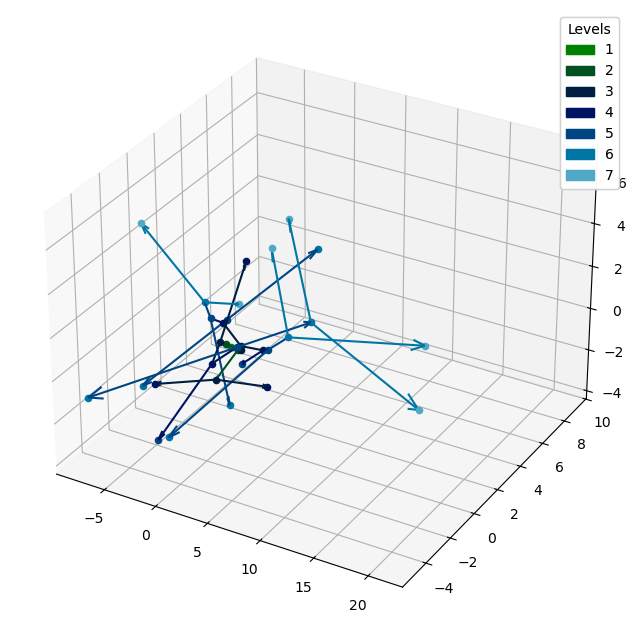

In [357]:
#PCA on leaves
Ppevecs, Ppevals, a = phylo_PCA(C_leaves, leaf_values)

# Align root estimate 'a' 
root_shape_2d = a.squeeze().reshape((n_landmarks, 2))
_, aligned_root, _ = procrustes(reference_shape, root_shape_2d)
# Flatten the aligned root shape back to (234,)
aligned_root_flat = aligned_root.reshape((n_landmarks * 2,))

# Create the correct shape container: (1, 26, 234)
reshaped_root = np.full((1, n_timesteps, n_coords), np.nan)
reshaped_root[0, -1, :] = aligned_root_flat  # insert only into last timestep

# Insert aligned root data into tree
tree.data['value'] = tree.data['value'].at[tree.is_root].set(reshaped_root)

a = tree.data['value'][tree.is_root][:,-1]

# Plot PCA features
features_leaves, features_inner = transform_data(leaf_values, estimated_inner, Ppevecs, a, 3)

tree.add_property('projected_value', shape=(3,))
    
tree.data['projected_value'] = tree.data['projected_value'].at[tree.is_leaf].set(features_leaves*100)
tree.data['projected_value'] = tree.data['projected_value'].at[tree.is_inner].set(features_inner*100)

plot_tree_3d_scatter(tree, 'projected_value')

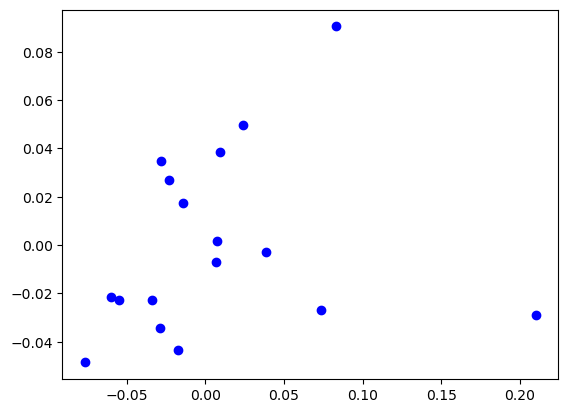

In [358]:
plt.scatter(features_leaves[:, 0], features_leaves[:, 1], label="PCA Features", color="blue", marker="o")

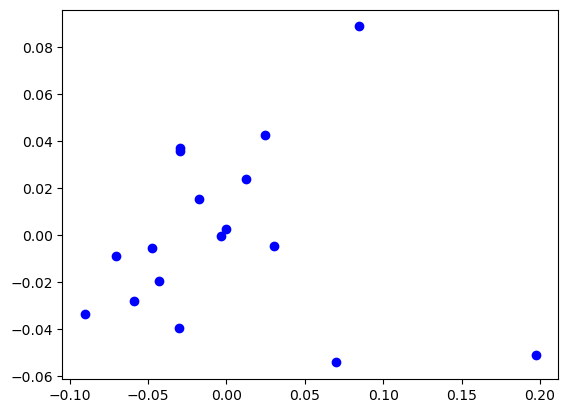

In [359]:
from sklearn.decomposition import PCA
import plotly.express as px

pca = PCA(n_components=2)
components = pca.fit_transform(leaf_values)
plt.scatter(components[:, 0], components[:, 1], label="PCA Features", color="blue", marker="o")

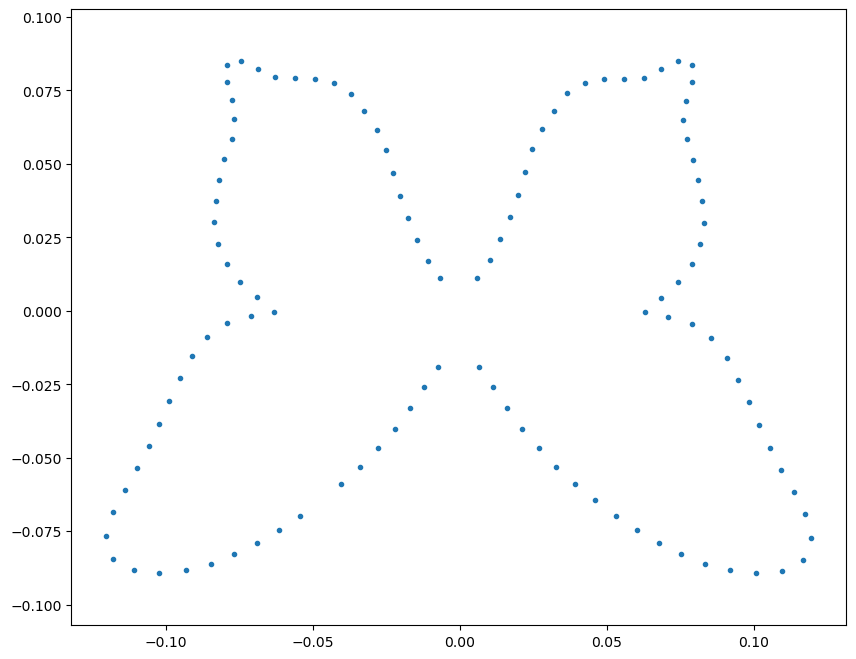

In [595]:
fig,ax = plt.subplots(figsize=(10,8))
plot_shape_2d(aligned_root_flat,ax=ax)

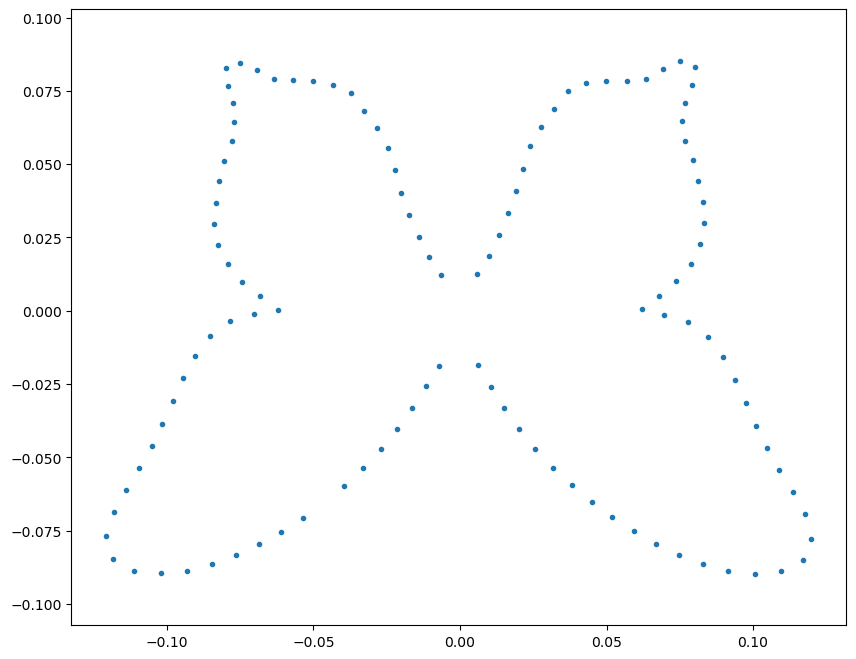

In [586]:
fig,ax = plt.subplots(figsize=(10,8))
plot_shape_2d(aligned_inner_flat[0],ax=ax)

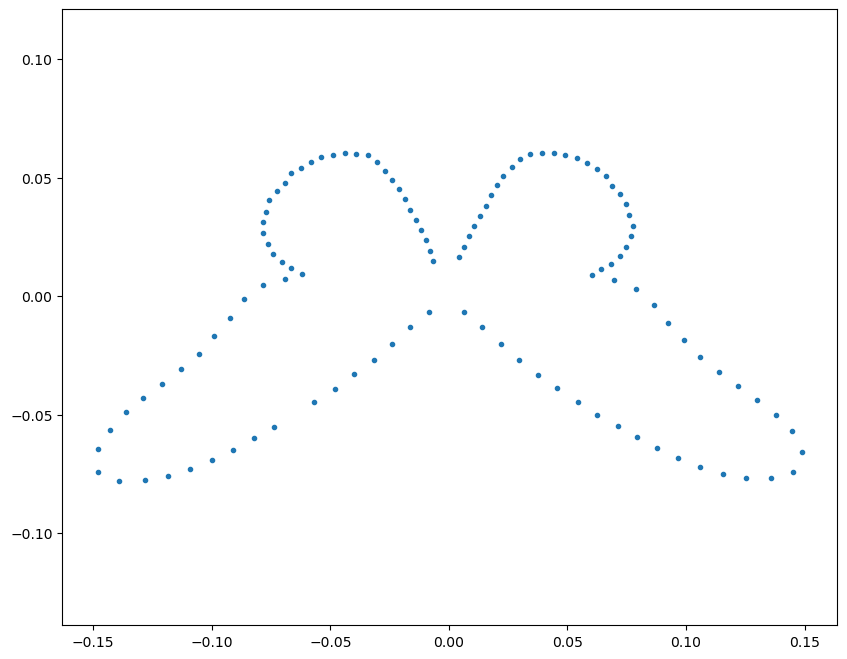

In [603]:
fig,ax = plt.subplots(figsize=(10,8))
plot_shape_2d(aligned_leaves_flat[12],ax=ax)

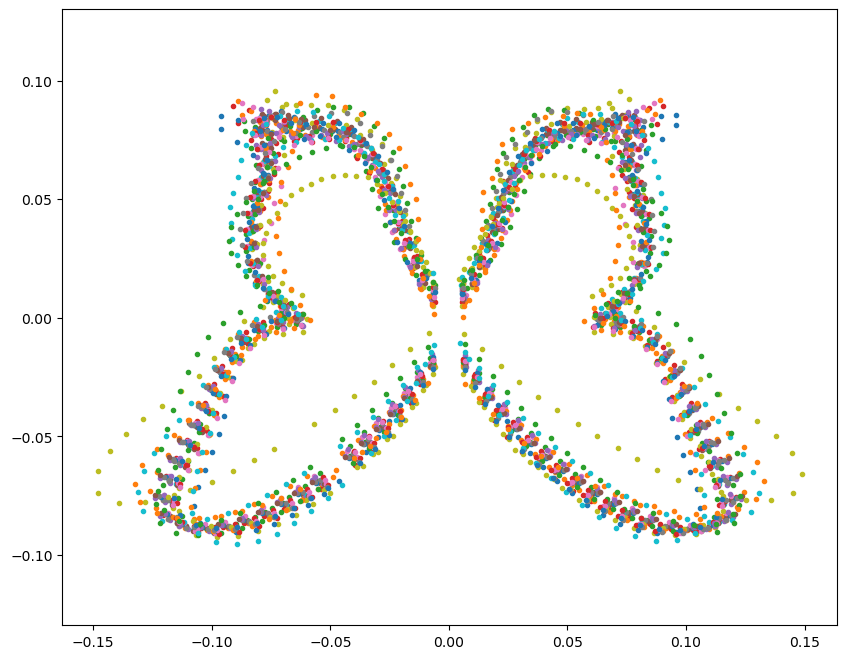

In [361]:
fig,ax = plt.subplots(figsize=(10,8))
for node in tree.iter_topology_bfs():
    plot_shape_2d(tree.data['value'][node.id][-1],ax=ax)

In [362]:
n_landmarks = 234 // 2

# Example: pick one leaf
leaf = list(tree.iter_topology_leaves_bfs())[0]
parent = leaf.parent

# Extract shapes
leaf_shape_flat = tree.data['value'][leaf.id][-1]
parent_shape_flat = tree.data['value'][parent.id][-1]

# Reshape to 2D (n_landmarks, 2)
leaf_shape_2d = leaf_shape_flat.reshape((n_landmarks, 2))
parent_shape_2d = parent_shape_flat.reshape((n_landmarks, 2))

In [363]:
def get_path_to_root(leaf):
    path = [leaf]
    while path[-1].parent is not None:
        path.append(path[-1].parent)
    return path[::-1]  # Reverse so root → leaf

In [364]:
n_landmarks = 234 // 2

def extract_shapes_along_path(path):
    shapes = []
    for node in path:
        shape_flat = tree.data['value'][node.id][-1]
        shape_2d = shape_flat.reshape((n_landmarks, 2))
        shapes.append(shape_2d)
    return shapes

In [365]:
def interpolate_path_shapes(shapes, n_frames_per_step=20):
    all_frames = []
    for i in range(len(shapes) - 1):
        start, end = shapes[i], shapes[i + 1]
        frames = [start * (1 - t) + end * t for t in np.linspace(0, 1, n_frames_per_step)]
        all_frames.extend(frames)
    return all_frames

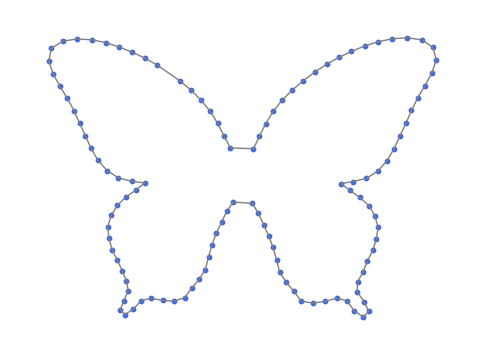

In [366]:
# 1. Get path from root to selected leaf
leaf = list(tree.iter_topology_leaves_bfs())[0]
path = get_path_to_root(leaf)

# 2. Extract flattened → reshaped shapes
n_landmarks = 234 // 2
path_shapes = []
for node in path:
    flat = tree.data['value'][node.id][-1]
    shape = flat.reshape((n_landmarks, 2))
    path_shapes.append(shape)

# 3. Skip alignment → use raw shapes
raw_shapes = path_shapes

# 4. Interpolate between shapes
n_frames_per_step = 20
interpolated = interpolate_path_shapes(raw_shapes, n_frames_per_step=n_frames_per_step)

# 5. Animate
fig, ax = plt.subplots(figsize=(6, 6))
ax.set_aspect('equal')
ax.axis('off')

sc = ax.scatter([], [], s=10, color='royalblue')
line, = ax.plot([], [], color='gray', linewidth=1)

# Adjust axis limits
all_points = np.vstack(interpolated)
x_margin = all_points[:, 0].ptp() * 0.1
y_margin = all_points[:, 1].ptp() * 0.1
ax.set_xlim(all_points[:, 0].min() - x_margin, all_points[:, 0].max() + x_margin)
ax.set_ylim(all_points[:, 1].min() - y_margin, all_points[:, 1].max() + y_margin)
ax.invert_yaxis()

def init():
    sc.set_offsets(np.zeros((n_landmarks, 2)))
    line.set_data([], [])
    return sc, line

def update(frame):
    shape = interpolated[frame]
    sc.set_offsets(shape)
    # Connect landmarks
    x = np.append(shape[:, 0], shape[0, 0])
    y = np.append(shape[:, 1], shape[0, 1])
    line.set_data(x, y)
    return sc, line

ani = animation.FuncAnimation(fig, update, frames=len(interpolated),
                              init_func=init, blit=True, interval=50)

from IPython.display import HTML
HTML(ani.to_jshtml())


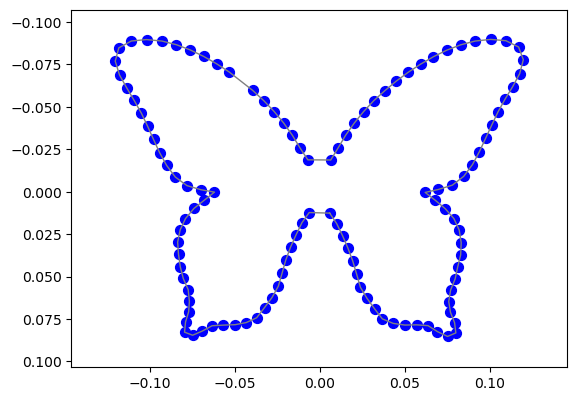

In [367]:

# Example landmarks (n points, 2D)
ancestor_lm = leaf_shape_2d
descendant_lm = parent_shape_2d

# Interpolation steps
n_frames = 50
interpolated_shapes = [
    ancestor_lm * (1 - t) + descendant_lm * t
    for t in np.linspace(0, 1, n_frames)
]

# Animation setup
fig, ax = plt.subplots()
sc = ax.scatter([], [], s=2, color='blue')  
line, = ax.plot([], [], color='gray', linewidth=1)
ax.set_aspect('equal')

# Set axis limits dynamically based on data range
all_points = np.vstack([ancestor_lm, descendant_lm])
x_margin = (all_points[:, 0].max() - all_points[:, 0].min()) * 0.1
y_margin = (all_points[:, 1].max() - all_points[:, 1].min()) * 0.1
ax.set_xlim(all_points[:, 0].min() - x_margin, all_points[:, 0].max() + x_margin)
ax.set_ylim(all_points[:, 1].min() - y_margin, all_points[:, 1].max() + y_margin)
ax.invert_yaxis()

# Plot elements
sc = ax.scatter([], [], s=50, color='blue')

def init():
    sc.set_offsets(np.zeros((ancestor_lm.shape[0], 2)))
    line.set_data([], [])
    return sc, line

def update(frame):
    shape = interpolated_shapes[frame]
    sc.set_offsets(shape)
    # Connect dots in order + close the loop
    x = np.append(shape[:, 0], shape[0, 0])
    y = np.append(shape[:, 1], shape[0, 1])
    line.set_data(x, y)
    return sc, line


ani = animation.FuncAnimation(
    fig, update, frames=n_frames, init_func=init, blit=True, interval=50
)

HTML(ani.to_jshtml())



In [412]:
from matplotlib import pyplot as plt
from matplotlib import patches as mpatch

cmap = lambda x: plt.cm.ocean(x*.9) # use a slightly darker color for the levels

def plot_tree_2d_scatter(tree: HypTree, property: str, ax=None, selector=lambda z: z, max_level=None):
    if ax is None:
        fig, ax = plt.subplots(figsize=(10, 8))

    # --- Compute global axis limits ---
    all_coords = []
    for node in tree.iter_topology_dfs():
        val = selector(tree.data[property][node.id])
        val = val if len(val.shape) == 1 else val[-1]
        if len(val.shape) == 1:
            all_coords.append(val[:2])
        else:
            all_coords.extend(val[:, :2])
    all_coords = np.array(all_coords)
    x_min, x_max = all_coords[:, 0].min(), all_coords[:, 0].max()
    y_min, y_max = all_coords[:, 1].min(), all_coords[:, 1].max()
    x_margin = (x_max - x_min) * 0.1
    y_margin = (y_max - y_min) * 0.1
    ax.set_xlim(x_min - x_margin, x_max + x_margin)
    ax.set_ylim(y_min - y_margin, y_max + y_margin)

    visible_nodes = set()
    for i, (l_start, l_end) in enumerate(tree.levels):
        if max_level is not None and i > max_level:
            break
        visible_nodes.update(range(l_start, l_end))

    for i, (l_start, l_end) in enumerate(tree.levels):
        if max_level is not None and i > max_level:
            break

        for nodeidx in range(l_start, l_end):
            cdat = selector(tree.data[property][nodeidx])
            cdat = cdat if len(cdat.shape) == 1 else cdat[-1]
            color = cmap(i / len(tree.levels))
            if len(cdat.shape) == 1:
                ax.scatter(*cdat[:2], color=color)
            else:
                ax.scatter(cdat[:, 0], cdat[:, 1], color=color)

            if nodeidx == 0:
                continue
            parentidx = tree.parents[nodeidx]
            if nodeidx not in visible_nodes or parentidx not in visible_nodes:
                continue  # Only draw branches where both ends are visible

            dat = selector(tree.data[property][parentidx])
            dat = dat if len(dat.shape) == 1 else dat[-1]
            if len(cdat.shape) == 1:
                ax.arrow(*dat[:2], *(cdat[:2] - dat[:2]), width=0.01, length_includes_head=True, color=color)
            elif len(cdat.shape) == 2:
                ax.plot(cdat[:, 0], cdat[:, 1], color=color)
            elif len(cdat.shape) == 3:
                for j in range(cdat.shape[1]):
                    ax.plot(cdat[:, j, 0], cdat[:, j, 1], color=color)

    handles = [mpatch.Patch(color=cmap(i / len(tree.levels)), label=f'{i+1}')
               for i in range(len(tree.levels)) if max_level is None or i <= max_level]
    ax.legend(handles=handles, title="Levels")
    ax.grid(True)

def plot_tree_3d_scatter(tree: HypTree, property: str, ax=None, selector=lambda z: z, max_level=None):
    if ax is None:
        fig = plt.figure(figsize=(10, 8))
        ax = fig.add_subplot(111, projection='3d')

    # --- Compute global axis limits ---
    all_coords = []
    for node in tree.iter_topology_dfs():
        val = selector(tree.data[property][node.id])
        val = val if len(val.shape) == 1 else val[-1]
        if len(val.shape) == 1:
            all_coords.append(val[:3])
        else:
            all_coords.extend(val[:, :3])
    all_coords = np.array(all_coords)
    for dim in range(3):
        min_val = all_coords[:, dim].min()
        max_val = all_coords[:, dim].max()
        margin = (max_val - min_val) * 0.1
    ax.set_xlim(all_coords[:, 0].min() - margin, all_coords[:, 0].max() + margin)
    ax.set_ylim(all_coords[:, 1].min() - margin, all_coords[:, 1].max() + margin)
    ax.set_zlim(all_coords[:, 2].min() - margin, all_coords[:, 2].max() + margin)

    levels = list(tree.iter_topology_levels())

    visible_ids = set()
    for i, level in enumerate(levels):
        if max_level is not None and i > max_level:
            break
        visible_ids.update(node.id for node in level)

    for i, level in enumerate(levels):
        if max_level is not None and i > max_level:
            break

        for node in level:
            dat = selector(tree.data[property][node.id])
            dat = dat if len(dat.shape) == 1 else dat[-1]
            color = cmap(i / len(tree.levels))
            if len(dat.shape) == 1:
                ax.scatter(*dat[:3], color=color)
            else:
                ax.scatter(dat[:, 0], dat[:, 1], dat[:, 2], color=color)

            if 'name' in tree.data:
                ax.text(*dat[:3], tree.data['name'][node.id], color='black')

            for child in node.children:
                if child.id not in visible_ids:
                    continue  # Skip invisible child nodes

                cdat = selector(tree.data[property][child.id])
                cdat = cdat if len(cdat.shape) == 1 else cdat[-1]
                if len(cdat.shape) == 1:
                    ax.quiver(*dat[:3], *(cdat[:3] - dat[:3]), length=1.0, arrow_length_ratio=0.1, color=color)
                elif len(cdat.shape) == 2:
                    ax.plot(cdat[:, 0], cdat[:, 1], cdat[:, 2], color=color)
                elif len(cdat.shape) == 3:
                    for j in range(cdat.shape[1]):
                        ax.plot(cdat[:, j, 0], cdat[:, j, 1], cdat[:, j, 2], color=color)

    handles = [mpatch.Patch(color=cmap(i / len(levels)), label=f'{i+1}')
               for i in range(len(levels)) if max_level is None or i <= max_level]
    ax.legend(handles=handles, title="Levels")
    ax.grid(True)


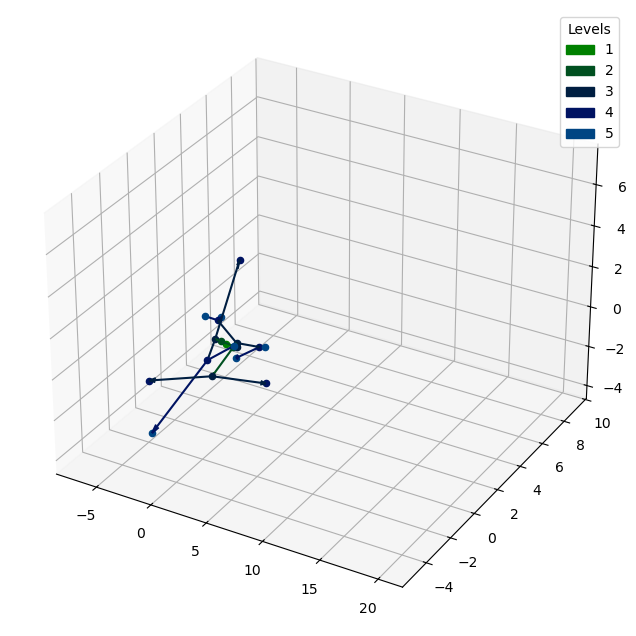

In [420]:
plot_tree_3d_scatter(tree, 'projected_value', max_level=4)

In [575]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

def animate_tree_3d_growth(tree, property: str, selector=lambda z: z, interval=1000, save=False, filename="tree_animation.mp4"):
    from mpl_toolkits.mplot3d import Axes3D  # ensure 3D projection works
    import matplotlib.pyplot as plt

    num_levels = len(tree.levels)

    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')

    def update(level):
        ax.cla()  # clear the axis before re-plotting
        plot_tree_3d_scatter(tree, property, ax=ax, selector=selector, max_level=level)
        ax.set_title(f"Tree up to Level {level+1}")

    ani = FuncAnimation(fig, update, frames=range(num_levels), interval=interval, repeat=False)

    if save:
        ani.save(filename, writer='ffmpeg')
    else:
        return HTML(ani.to_jshtml())


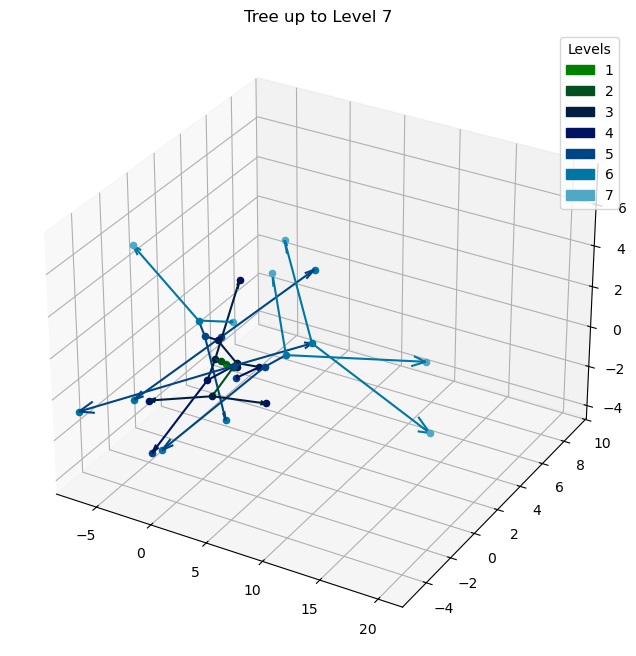

In [577]:
animate_tree_3d_growth(tree, 'projected_value')


In [623]:

def animate_tree_and_shape(tree, tip_index=0, n_total_frames=100):
    leaf = list(tree.iter_topology_leaves_bfs())[tip_index]
    path = get_path_to_root(leaf)  # root to tip
    
    def get_edge_length(node):
        # Use the branch length from the destination node (child node)
        return float(tree.data['edge_length'][node.id][0])

    # --- Compute edge lengths and frame allocation ---
    edge_lengths = [get_edge_length(path[i + 1]) for i in range(len(path) - 1)]
    cumulative_times = [0.0]
    for length in edge_lengths:
        cumulative_times.append(cumulative_times[-1] + length)

    total_time = cumulative_times[-1]
    
    time_steps = np.linspace(0, total_time, n_total_frames)

    # Distribute frames based on edge lengths
    branch_frame_counts = [max(1, int(round(length / total_time * n_total_frames))) for length in edge_lengths]

    # Adjust frame allocation to match exactly n_total_frames
    frame_diff = n_total_frames - sum(branch_frame_counts)
    if frame_diff > 0:
        # If we have fewer frames than needed, distribute the extra frames
        for i in range(frame_diff):
            branch_frame_counts[i % len(branch_frame_counts)] += 1
    elif frame_diff < 0:
        # If we have more frames than needed, reduce the frame count proportionally
        for i in range(len(branch_frame_counts)):
            if branch_frame_counts[i] > 1:
                branch_frame_counts[i] -= 1

    # --- Interpolate both shape and 3D path ---
    interpolated_shapes = []
    interpolated_path = []

    def safe_last(data):
        return data if len(data.shape) == 1 else data[-1]

    for t in time_steps:
        for i in range(len(path) - 1):
            t0 = cumulative_times[i]
            t1 = cumulative_times[i + 1]
            if t0 <= t <= t1:
                alpha = (t - t0) / (t1 - t0)  # normalized position on this branch
                parent = path[i]
                child = path[i + 1]

                # Morph shape
                shape_p = safe_last(tree.data['value'][parent.id]).reshape(-1, 2)
                shape_c = safe_last(tree.data['value'][child.id]).reshape(-1, 2)
                shape_interp = (1 - alpha) * shape_p + alpha * shape_c
                interpolated_shapes.append(shape_interp)

                # Morph 3D path
                coord_p = safe_last(tree.data['projected_value'][parent.id])[:3]
                coord_c = safe_last(tree.data['projected_value'][child.id])[:3]
                coord_interp = (1 - alpha) * coord_p + alpha * coord_c
                interpolated_path.append(coord_interp)
                break  # Once branch is found, move to next time step


    # Adjust interpolated shapes and path to fit the max frame count
    current_shape_frames = len(interpolated_shapes)

    # Ensure the frames are at least 1 and fit within the maximum frame count
    if current_shape_frames < n_total_frames:
        # Upsample if there are fewer frames than n_total_frames
        extra_frames = n_total_frames - current_shape_frames
        interpolated_shapes.extend(interpolated_shapes[:extra_frames])  # Repeat data
        interpolated_path.extend(interpolated_path[:extra_frames])  # Repeat data
    elif current_shape_frames > n_total_frames:
        # Downsample if there are more frames than n_total_frames
        step = current_shape_frames // n_total_frames
        interpolated_shapes = interpolated_shapes[::step]
        interpolated_path = interpolated_path[::step]

    # --- Setup figure ---
    fig = plt.figure(figsize=(12, 6))
    ax_tree = fig.add_subplot(121, projection='3d')
    ax_shape = fig.add_subplot(122)

    # Set tree axis limits
    all_coords = np.array([
        safe_last(tree.data['projected_value'][node.id])[:3]
        for node in tree.iter_topology_dfs()
    ])
    margin = (all_coords.max(axis=0) - all_coords.min(axis=0)) * 0.1
    for dim, setter in zip(range(3), [ax_tree.set_xlim, ax_tree.set_ylim, ax_tree.set_zlim]):
        setter(all_coords[:, dim].min() - margin[dim], all_coords[:, dim].max() + margin[dim])

    # Static tree points
    for node in tree.iter_topology_dfs():
        coord = safe_last(tree.data['projected_value'][node.id])[:3]
        ax_tree.scatter(*coord, color='lightgray', s=5)

    red_dot = ax_tree.scatter([], [], [], color='red', s=40)

    # Shape axis setup
    ax_shape.set_aspect('equal')
    ax_shape.axis('off')
    sc = ax_shape.scatter([], [], s=10, color='royalblue')
    line, = ax_shape.plot([], [], color='gray', linewidth=1)

    # Set axis limits for shape
    all_shape_points = np.vstack(interpolated_shapes)
    x_margin = all_shape_points[:, 0].ptp() * 0.1
    y_margin = all_shape_points[:, 1].ptp() * 0.1
    ax_shape.set_xlim(all_shape_points[:, 0].min() - x_margin, all_shape_points[:, 0].max() + x_margin)
    ax_shape.set_ylim(all_shape_points[:, 1].min() - y_margin, all_shape_points[:, 1].max() + y_margin)
    ax_shape.invert_yaxis()
    
    # Store edge lines to be added dynamically
    branch_lines = []
    node_scatters = []
    revealed_nodes = set()
    
    def init():
        red_dot._offsets3d = ([], [], [])
        sc.set_offsets(np.zeros((n_landmarks, 2)))
        line.set_data([], [])

        # Show only the root node at the beginning
        root = path[0]
        coord = safe_last(tree.data['projected_value'][root.id])[:3]
        scatter = ax_tree.scatter(*coord, color='black', s=10)
        node_scatters.append(scatter)
        revealed_nodes.add(root.id)

        return sc, line, red_dot, *node_scatters, *branch_lines

    def update(frame):
        shape = interpolated_shapes[frame]
        sc.set_offsets(shape)
        x = np.append(shape[:, 0], shape[0, 0])
        y = np.append(shape[:, 1], shape[0, 1])
        line.set_data(x, y)

        pos = interpolated_path[frame]
        red_dot._offsets3d = ([pos[0]], [pos[1]], [pos[2]])
        
                # Reveal nodes and branches up to this frame
        for i in range(len(path) - 1):
            parent = path[i]
            child = path[i + 1]
            t0 = cumulative_times[i]
            t1 = cumulative_times[i + 1]

            if t0 <= time_steps[frame] and child.id not in revealed_nodes:
                # Reveal child node
                coord_c = safe_last(tree.data['projected_value'][child.id])[:3]
                scatter = ax_tree.scatter(*coord_c, color='black', s=10)
                node_scatters.append(scatter)
                revealed_nodes.add(child.id)

                # Reveal edge (line from parent to child)
                coord_p = safe_last(tree.data['projected_value'][parent.id])[:3]
                line_seg, = ax_tree.plot(
                    [coord_p[0], coord_c[0]],
                    [coord_p[1], coord_c[1]],
                    [coord_p[2], coord_c[2]],
                    color='gray',
                    linewidth=1
                )
                branch_lines.append(line_seg)

        
        return sc, line, red_dot, *node_scatters, *branch_lines

    ani = animation.FuncAnimation(fig, update, init_func=init,
                                  frames=n_total_frames, blit=True, interval=50)

    return ani


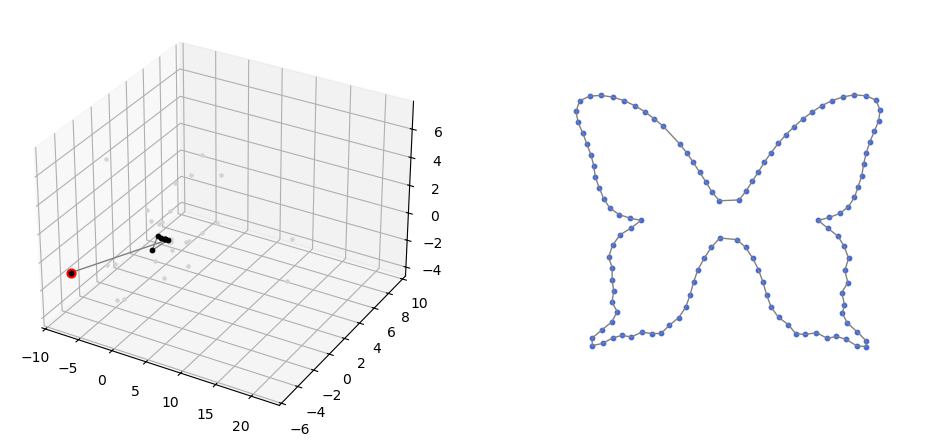

In [624]:
ani = animate_tree_and_shape(tree, tip_index=6, n_total_frames=95)
HTML(ani.to_jshtml())
# Save as an MP4 file
#ani.save('tree_and_shape_animation.mp4', writer='ffmpeg', fps=30)

In [584]:
from scipy.stats import spearmanr

# For each tip:
phylo_lengths = []   # Sum of edge lengths from root to tip
pca_lengths = []     # Sum of Euclidean distances between projected nodes in PCA space

for leaf in tree.iter_topology_leaves_bfs():
    path = get_path_to_root(leaf)

    # Phylogenetic length
    phylo_lengths.append(sum(tree.data['edge_length'][n.id][0] for n in path[1:]))

    # PCA space length
    pca_dist = 0
    for i in range(len(path) - 1):
        p1 = tree.data['projected_value'][path[i].id][:3]
        p2 = tree.data['projected_value'][path[i + 1].id][:3]
        pca_dist += np.linalg.norm(p2 - p1)
    pca_lengths.append(pca_dist)

# Correlation
r, p = spearmanr(phylo_lengths, pca_lengths)
print(f"Spearman correlation: r = {r:.3f}, p = {p:.3g}")


Spearman correlation: r = -0.203, p = 0.433


Dropdown(description='Butterfly:', layout=Layout(width='50%'), options=(('Papilio Gigon', 0), ('Papilio Deipho…

Output()

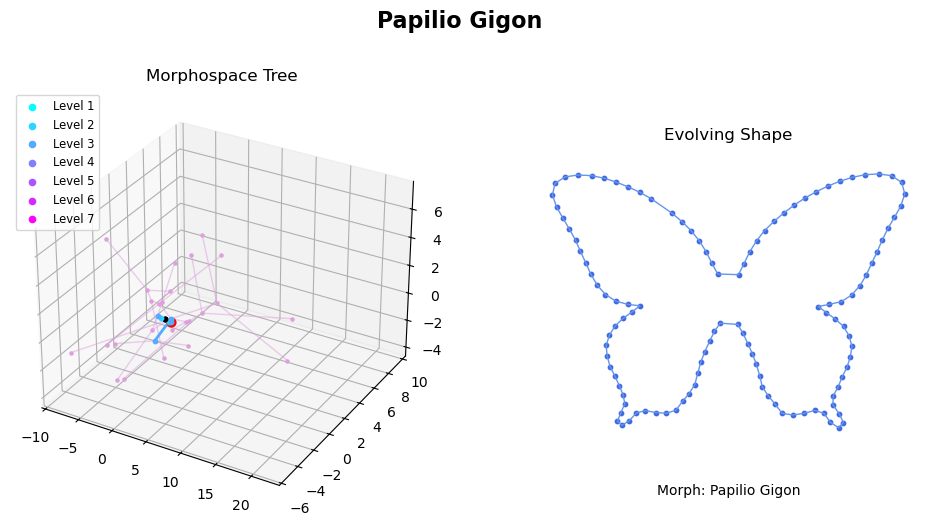

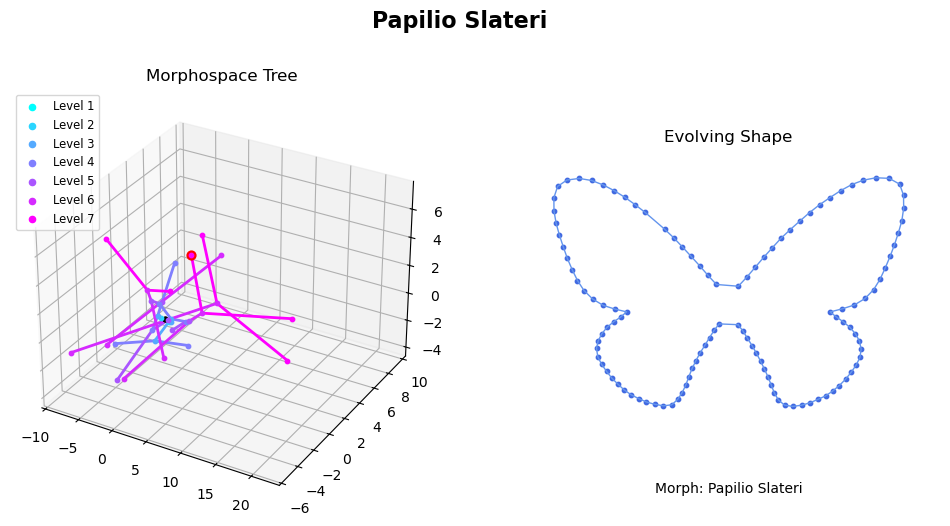

In [695]:
from matplotlib import cm
from matplotlib.colors import to_hex
import ipywidgets as widgets
from IPython.display import display, HTML, clear_output


def animate_tree_and_shape(tree, tip_index=0, n_total_frames=100):
    leaf = list(tree.iter_topology_leaves_bfs())[tip_index]
    path = get_path_to_root(leaf)
    
    def format_name(name):
        return name.replace("_", " ").title()

    def get_edge_length(node):
        return float(tree.data['edge_length'][node.id][0])

    leaf_name = format_name(leaf.name) if leaf.name else "Unknown Butterfly"
    edge_lengths = [get_edge_length(path[i + 1]) for i in range(len(path) - 1)]
    cumulative_times = [0.0]
    for length in edge_lengths:
        cumulative_times.append(cumulative_times[-1] + length)

    total_time = cumulative_times[-1]
    time_steps = np.linspace(0, total_time, n_total_frames)

    def safe_last(data):
        return data if len(data.shape) == 1 else data[-1]

    n_landmarks = safe_last(tree.data['value'][path[0].id]).reshape(-1, 2).shape[0]

    interpolated_shapes = []
    interpolated_path = []

    for t in time_steps:
        for i in range(len(path) - 1):
            t0 = cumulative_times[i]
            t1 = cumulative_times[i + 1]
            if t0 <= t <= t1:
                alpha = (t - t0) / (t1 - t0)
                parent, child = path[i], path[i + 1]

                shape_p = safe_last(tree.data['value'][parent.id]).reshape(-1, 2)
                shape_c = safe_last(tree.data['value'][child.id]).reshape(-1, 2)
                shape_interp = (1 - alpha) * shape_p + alpha * shape_c
                interpolated_shapes.append(shape_interp)

                coord_p = safe_last(tree.data['projected_value'][parent.id])[:3]
                coord_c = safe_last(tree.data['projected_value'][child.id])[:3]
                coord_interp = (1 - alpha) * coord_p + alpha * coord_c
                interpolated_path.append(coord_interp)
                break

    current_shape_frames = len(interpolated_shapes)
    if current_shape_frames < n_total_frames:
        extra = n_total_frames - current_shape_frames
        interpolated_shapes.extend(interpolated_shapes[:extra])
        interpolated_path.extend(interpolated_path[:extra])
    elif current_shape_frames > n_total_frames:
        step = current_shape_frames // n_total_frames
        interpolated_shapes = interpolated_shapes[::step]
        interpolated_path = interpolated_path[::step]

    # Prepare level colors
    unique_levels = sorted({int(tree.data['level'][node.id][0]) for node in tree.iter_topology_dfs()})
    level_colors = {level: to_hex(cm.cool(level / max(unique_levels))) for level in unique_levels}

    # --- Plot setup ---
    fig = plt.figure(figsize=(12, 6))
    ax_tree = fig.add_subplot(121, projection='3d')
    ax_shape = fig.add_subplot(122)
    fig.suptitle(leaf_name, fontsize=16, fontweight='bold')               # Overall title
    ax_tree.set_title("Morphospace Tree", fontsize=12)                    # Left plot
    ax_shape.set_title("Evolving Shape", fontsize=12)                     # Right plot
    # Placeholder for dynamic node name
    morph_label = ax_shape.text(0.5, -0.1, "", fontsize=10, ha='center', va='top', transform=ax_shape.transAxes)


    all_coords = np.array([
        safe_last(tree.data['projected_value'][node.id])[:3]
        for node in tree.iter_topology_dfs()
    ])
    margin = (all_coords.max(axis=0) - all_coords.min(axis=0)) * 0.1
    for dim, setter in zip(range(3), [ax_tree.set_xlim, ax_tree.set_ylim, ax_tree.set_zlim]):
        setter(all_coords[:, dim].min() - margin[dim], all_coords[:, dim].max() + margin[dim])

    for node in tree.iter_topology_dfs():
        coord = safe_last(tree.data['projected_value'][node.id])[:3]
        ax_tree.scatter(*coord, color='plum', s=5)
        
    for node in tree.iter_topology_dfs():
        parent = node.parent
        if parent is not None:
            coord_p = safe_last(tree.data['projected_value'][parent.id])[:3]
            coord_c = safe_last(tree.data['projected_value'][node.id])[:3]
            ax_tree.plot(
                [coord_p[0], coord_c[0]],
                [coord_p[1], coord_c[1]],
                [coord_p[2], coord_c[2]],
                color='plum',
                linewidth=1,
                alpha=0.5
            )

    red_dot = ax_tree.scatter([], [], [], color='red', s=40)

    ax_shape.set_aspect('equal')
    ax_shape.axis('off')
    sc = ax_shape.scatter([], [], s=10, color='royalblue')
    line, = ax_shape.plot([], [], color='cornflowerblue', linewidth=1)

    all_shape_points = np.vstack(interpolated_shapes)
    x_margin = all_shape_points[:, 0].ptp() * 0.1
    y_margin = all_shape_points[:, 1].ptp() * 0.1
    ax_shape.set_xlim(all_shape_points[:, 0].min() - x_margin, all_shape_points[:, 0].max() + x_margin)
    ax_shape.set_ylim(all_shape_points[:, 1].min() - y_margin, all_shape_points[:, 1].max() + y_margin)
    ax_shape.invert_yaxis()

    # Animation state
    branch_lines = []
    node_scatters = []
    revealed_nodes = set()

    def init():
        red_dot._offsets3d = ([], [], [])
        sc.set_offsets(np.zeros((n_landmarks, 2)))
        line.set_data([], [])

        root = path[0]
        coord = safe_last(tree.data['projected_value'][root.id])[:3]
        scatter = ax_tree.scatter(*coord, color='black', s=10)
        node_scatters.append(scatter)
        revealed_nodes.add(root.id)

        return sc, line, red_dot, *node_scatters, *branch_lines

    def update(frame):
        shape = interpolated_shapes[frame]
        sc.set_offsets(shape)
        x = np.append(shape[:, 0], shape[0, 0])
        y = np.append(shape[:, 1], shape[0, 1])
        line.set_data(x, y)

        pos = interpolated_path[frame]
        red_dot._offsets3d = ([pos[0]], [pos[1]], [pos[2]])

        time_now = time_steps[frame]
        # Determine current level based on time
        for i in range(len(path) - 1):
            t0 = cumulative_times[i]
            t1 = cumulative_times[i + 1]
            if t0 <= time_now < t1:
                current_level = int(tree.data['level'][path[i + 1].id][0])
                break
        else:
            current_level = int(tree.data['level'][path[-1].id][0])  # fallback to last

        # Reveal all branches and nodes at this level
        for node in tree.iter_topology_dfs():
            node_level = int(tree.data['level'][node.id][0])
            if node_level == current_level and node.id not in revealed_nodes:
                parent = node.parent
                if parent is not None:
                    coord_p = safe_last(tree.data['projected_value'][parent.id])[:3]
                    coord_c = safe_last(tree.data['projected_value'][node.id])[:3]
                    color = level_colors.get(node_level, 'magenta')

                    line_seg, = ax_tree.plot(
                        [coord_p[0], coord_c[0]],
                        [coord_p[1], coord_c[1]],
                        [coord_p[2], coord_c[2]],
                        color=color,
                        linewidth=2
                    )
                    branch_lines.append(line_seg)

                coord = safe_last(tree.data['projected_value'][node.id])[:3]
                scatter = ax_tree.scatter(*coord, color=color, s=10)
                node_scatters.append(scatter)
                revealed_nodes.add(node.id)
                
                # Set butterfly name as title
                # Set dynamic subtitle (current node name) based on where red dot is
                for i in range(len(path) - 1):
                    t0 = cumulative_times[i]
                    t1 = cumulative_times[i + 1]
                    if t0 <= time_now < t1:
                        current_node = path[i + 1]
                        break
                else:
                    current_node = path[-1]

                if current_node.name:
                    morph_label.set_text(f"Morph: {format_name(current_node.name)}")


        return sc, line, red_dot, *node_scatters, *branch_lines

    ani = animation.FuncAnimation(fig, update, init_func=init,
                                  frames=n_total_frames, blit=True, interval=50)

    # Add legend
    for level in unique_levels:
        ax_tree.scatter([], [], [], color=level_colors[level], label=f'Level {level + 1}')
    ax_tree.legend(loc='upper left', fontsize='small')

    return ani

import ipywidgets as widgets
from IPython.display import display, HTML, clear_output

# List all leaf names with their index
leaf_nodes = list(tree.iter_topology_leaves_bfs())
tip_options = [(node.name.replace('_', ' ').title(), i) for i, node in enumerate(leaf_nodes)]

dropdown = widgets.Dropdown(
    options=tip_options,
    description='Butterfly:',
    layout=widgets.Layout(width='50%')
)

output = widgets.Output()

def on_change(change):
    if change['type'] == 'change' and change['name'] == 'value':
        with output:
            clear_output(wait=True)
            ani = animate_tree_and_shape(tree, tip_index=change['new'], n_total_frames=100)
            display(HTML(ani.to_jshtml()))

dropdown.observe(on_change)
display(dropdown, output)

# Initial animation
with output:
    ani = animate_tree_and_shape(tree, tip_index=0, n_total_frames=100)
    display(HTML(ani.to_jshtml()))


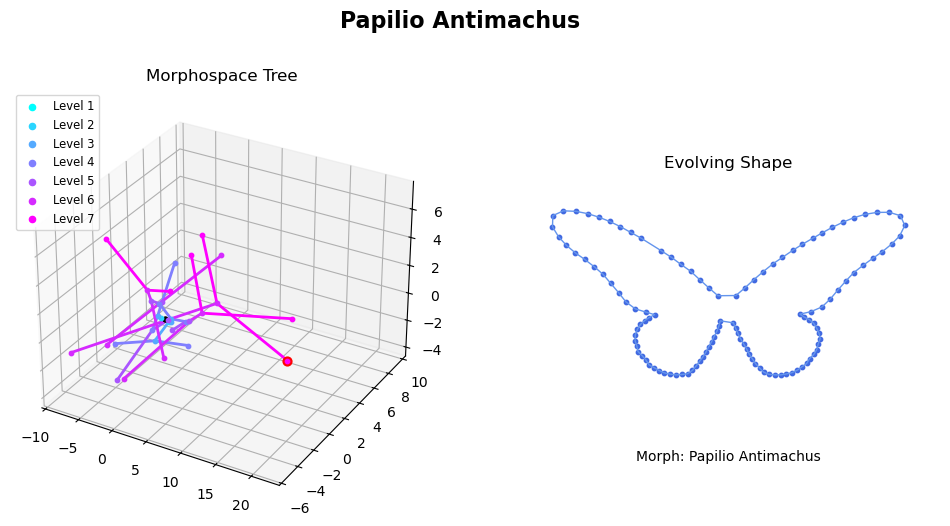

In [694]:
ani = animate_tree_and_shape(tree, tip_index=12, n_total_frames=100)
#HTML(ani.to_jshtml())
ani.save('tree_and_shape_animation.mp4', writer='ffmpeg', fps=30)

In [697]:
with open("my_tree.pkl", "wb") as f:
    pickle.dump(tree, f)